### Exploratory Data Analysis

,time,A,B,C,D,E,F,G,H,I,J,K,L,M,N,Y1,Y2
0,0,0.207366,-0.159951,-0.634176,-0.580962,-0.266505,0.060173,-0.475257,-1.486516,-0.332594,-0.671466,-0.226149,-0.187624,-0.780237,-0.785965,-0.935902,-0.310081
1,1,0.188828,-0.265508,0.042143,-0.550442,-0.132319,-0.185219,0.028295,0.093210,-0.518139,-0.251917,-0.347845,-0.359069,-0.161254,0.020401,-0.089707,-0.305374
2,2,-0.144261,-0.577142,-0.214634,-0.747391,-0.184255,-0.464831,-0.085181,0.700449,-0.603438,0.197773,-0.566696,-0.580799,0.202726,0.135261,-0.077855,-0.631485
3,3,0.208982,-0.310449,0.513708,-0.562868,0.742308,-0.305487,0.762246,1.363020,-0.384575,0.525556,-0.348514,-0.428099,0.548993,0.471031,0.941271,-0.535212
4,4,0.093320,-0.358156,0.173188,-0.687296,-0.161461,-0.116062,-0.245748,0.863372,-0.655588,-0.263358,-0.557428,-0.481214,0.083602,0.003087,-0.039582,-0.490561


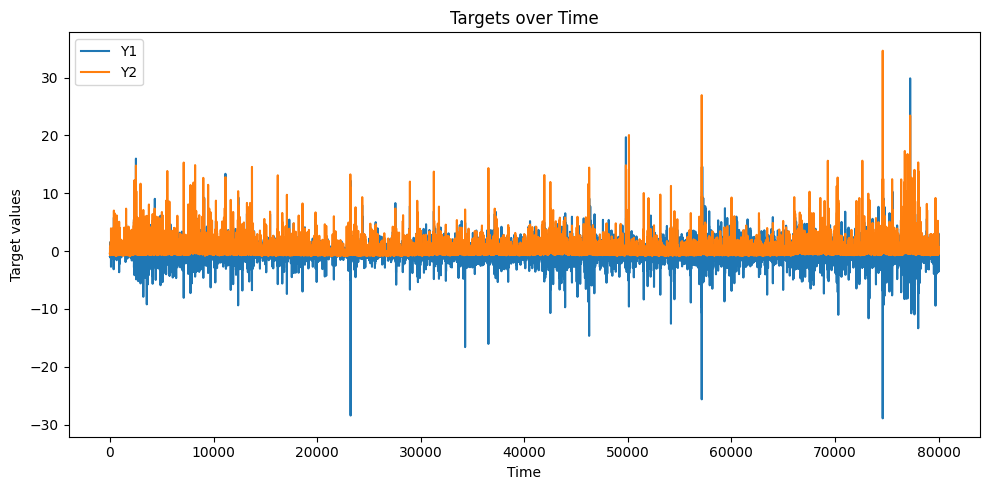

In [25]:
import pandas as pd
import matplotlib.pyplot as plt

df = pd.read_csv("train.csv")
display(df.head())

fig, ax = plt.subplots(figsize=(10, 5))
ax.plot(df["time"], df["Y1"], label="Y1")
ax.plot(df["time"], df["Y2"], label="Y2")
ax.set_xlabel("Time")
ax.set_ylabel("Target values")
ax.set_title("Targets over Time")
ax.legend()
plt.tight_layout()
plt.show()


In [26]:
import pandas as pd
import plotly.graph_objects as go



df = pd.read_csv("train.csv")
display(df.head())

value_cols = df.columns[df.columns.get_loc("A"): df.columns.get_loc("Y2") + 1]

fig = go.Figure()
for col in value_cols:
    fig.add_trace(
        go.Scatter(
            x=df["time"],
            y=df[col],
            mode="lines",
            name=col,
        )
    )

fig.update_layout(
    title="Train Columns A to Y2 over Time",
    xaxis_title="Time",
    yaxis_title="Value",
)

fig.show()

,time,A,B,C,D,E,F,G,H,I,J,K,L,M,N,Y1,Y2
0,0,0.207366,-0.159951,-0.634176,-0.580962,-0.266505,0.060173,-0.475257,-1.486516,-0.332594,-0.671466,-0.226149,-0.187624,-0.780237,-0.785965,-0.935902,-0.310081
1,1,0.188828,-0.265508,0.042143,-0.550442,-0.132319,-0.185219,0.028295,0.093210,-0.518139,-0.251917,-0.347845,-0.359069,-0.161254,0.020401,-0.089707,-0.305374
2,2,-0.144261,-0.577142,-0.214634,-0.747391,-0.184255,-0.464831,-0.085181,0.700449,-0.603438,0.197773,-0.566696,-0.580799,0.202726,0.135261,-0.077855,-0.631485
3,3,0.208982,-0.310449,0.513708,-0.562868,0.742308,-0.305487,0.762246,1.363020,-0.384575,0.525556,-0.348514,-0.428099,0.548993,0.471031,0.941271,-0.535212
4,4,0.093320,-0.358156,0.173188,-0.687296,-0.161461,-0.116062,-0.245748,0.863372,-0.655588,-0.263358,-0.557428,-0.481214,0.083602,0.003087,-0.039582,-0.490561


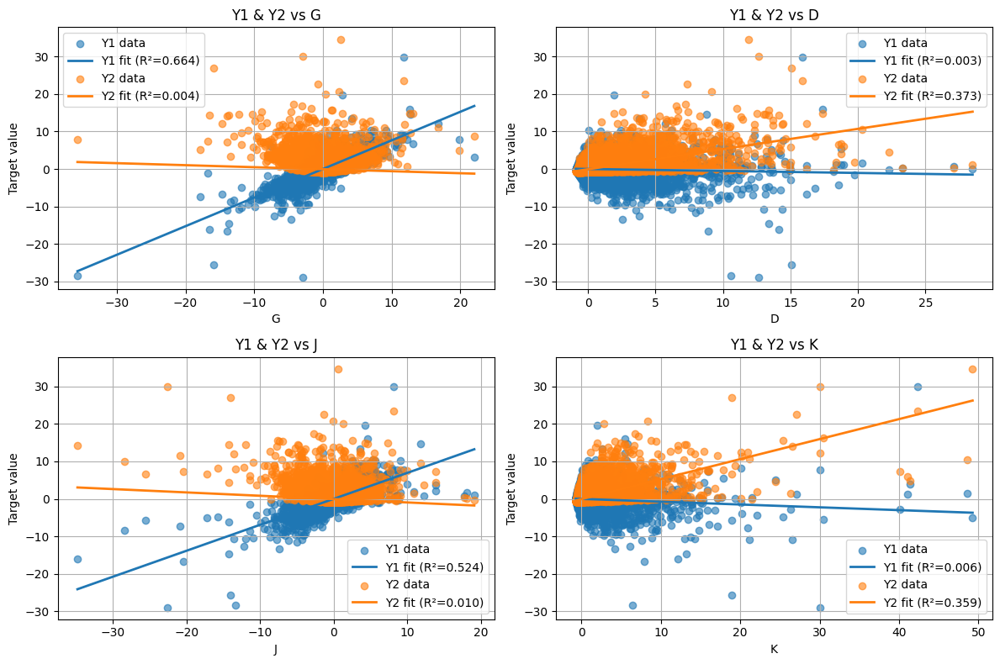


== G ==
Y1: y = 0.762991 * G + -0.00276929   (R²=0.664)
Y2: y = -0.0536489 * G + -0.0611749   (R²=0.004)

== D ==
Y1: y = -0.0529202 * D + -0.00111863   (R²=0.003)
Y2: y = 0.538961 * D + -0.0783721   (R²=0.373)

== J ==
Y1: y = 0.692113 * J + -0.00278842   (R²=0.524)
Y2: y = -0.0891488 * J + -0.0611747   (R²=0.010)

== K ==
Y1: y = -0.074992 * K + -0.00286765   (R²=0.006)
Y2: y = 0.533201 * K + -0.0607443   (R²=0.359)


In [57]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

def plot_lr_two_targets_grid(df: pd.DataFrame, features, y_cols=("Y1", "Y2")):
    """
    Create a 2x2 grid of subplots. Each subplot shows scatter + linear fits
    for the two target columns (default Y1, Y2) against one selected feature.

    Parameters
    ----------
    df : pd.DataFrame
        Source data.
    features : list/tuple of str
        Exactly four feature column names to visualize.
    y_cols : tuple of str
        Target column names, default ("Y1", "Y2").
    """
    # ---- validations ----
    if len(features) != 4:
        raise ValueError(f"`features` must have exactly 4 items, got {len(features)}.")

    missing = [c for c in [*features, *y_cols] if c not in df.columns]
    if missing:
        raise KeyError(f"Missing columns: {missing}")

    # ---- helper to compute model, preds, r2 ----
    def fit_lr(x, y):
        model = LinearRegression()
        model.fit(x, y)
        y_pred = model.predict(x)
        r2 = r2_score(y, y_pred)
        return model, y_pred, r2

    fig, axes = plt.subplots(2, 2, figsize=(12, 8))
    axes = axes.ravel()

    all_equations = []  # collect equations for printing

    for ax, feature in zip(axes, features):
        # Keep only what we need and force numeric, drop NA
        cols = [feature, *y_cols]
        data = df[cols].apply(pd.to_numeric, errors="coerce").dropna()
        if data.empty:
            raise ValueError(f"No valid rows left for feature '{feature}' after cleaning.")

        X = data[[feature]].to_numpy()
        x_min, x_max = X.min(), X.max()
        x_grid = np.linspace(x_min, x_max, 200).reshape(-1, 1)

        # Plot each target
        eqns_this_feature = []
        for y in y_cols:
            yv = data[y].to_numpy()

            model, y_pred, r2 = fit_lr(X, yv)

            # scatter
            ax.scatter(X.ravel(), yv, alpha=0.6, label=f"{y} data")
            # fitted line
            ax.plot(x_grid.ravel(), model.predict(x_grid), linewidth=2, label=f"{y} fit (R²={r2:.3f})")

            eqns_this_feature.append((y, model.coef_[0], model.intercept_, r2))

        ax.set_xlabel(feature)
        ax.set_ylabel("Target value")
        ax.set_title(f"{y_cols[0]} & {y_cols[1]} vs {feature}")
        ax.grid(True)
        ax.legend()

        all_equations.append((feature, eqns_this_feature))

    plt.tight_layout()
    plt.show()

    # ---- print equations for all subplots ----
    for feature, eqns in all_equations:
        print(f"\n== {feature} ==")
        for y, coef, intercept, r2 in eqns:
            print(f"{y}: y = {coef:.6g} * {feature} + {intercept:.6g}   (R²={r2:.3f})")

# ---- Example usage ----
if __name__ == "__main__":
    df = pd.read_csv("train.csv")  # adjust path as needed

    # choose 4 features to visualize (must be exactly 4)
    selected_features = ["G", "D", "J", "K"]   # <-- change these
    plot_lr_two_targets_grid(df, selected_features, y_cols=("Y1", "Y2"))


In [58]:
import pandas as pd
from sklearn.metrics import mean_squared_error, r2_score

# === PARAMETERS YOU CAN EDIT ===
file_path = "train.csv"  # Change if file is elsewhere
features = list("ABCDEFGHIJKLMN")  # Features A to N
targets = ["Y1", "Y2"]  # Targets

# Choose how to sort results (e.g., ["Correlation"], ["R2"], ["MSE"], or multiple)
# sort_by = ["R2"]  # Example: sort by R2 in descending order
sort_by = ["MSE"]  # Example: sort by R2 in descending order

# === FUNCTION TO COMPUTE METRICS ===
def compute_metrics(x, y):
    corr = x.corr(y)
    slope = ((x - x.mean()) * (y - y.mean())).sum() / ((x - x.mean())**2).sum()
    intercept = y.mean() - slope * x.mean()
    y_pred = slope * x + intercept
    r2 = r2_score(y, y_pred)
    mse = mean_squared_error(y, y_pred)
    return corr, r2, mse, slope

# === MAIN ===
train_df = pd.read_csv(file_path)

results = {}
for target in targets:
    metrics_list = []
    for feature in features:
        corr, r2, mse, slope = compute_metrics(train_df[feature], train_df[target])
        metrics_list.append({
            "Feature": feature,
            "Correlation": corr,
            "R2": r2,
            "MSE": mse,
            "Slope": slope
        })
    df = pd.DataFrame(metrics_list)
    df = df.sort_values(by=sort_by, ascending=[False]*len(sort_by))
    results[target] = df

# === DISPLAY RESULTS ===
for target, df in results.items():
    print(f"\nMetrics for {target} (sorted by {sort_by}):")
    display(df)


Metrics for Y1 (sorted by ['MSE']):


,Feature,Correlation,R2,MSE,Slope
0,A,-0.006105,0.000037,0.942125,-0.005496
3,D,-0.057097,0.003260,0.939088,-0.052920
11,L,-0.072366,0.005237,0.937226,-0.066401
5,F,-0.073191,0.005357,0.937113,-0.066446
10,K,-0.080196,0.006431,0.936101,-0.074992
8,I,-0.090226,0.008141,0.934490,-0.082235
1,B,-0.094995,0.009024,0.933658,-0.089431
13,N,0.595766,0.354938,0.607752,0.563962
4,E,0.684297,0.468262,0.500982,0.640991
12,M,0.686246,0.470933,0.498465,0.657726



Metrics for Y2 (sorted by ['MSE']):


,Feature,Correlation,R2,MSE,Slope
4,E,-0.044583,0.001988,0.851518,-0.039741
6,G,-0.060187,0.003622,0.850124,-0.053649
2,C,-0.073009,0.005330,0.848666,-0.066760
13,N,-0.080172,0.006427,0.847730,-0.072221
7,H,-0.086976,0.007565,0.846760,-0.077198
12,M,-0.095326,0.009087,0.845461,-0.086945
9,J,-0.097986,0.009601,0.845022,-0.089149
0,A,0.484746,0.234979,0.652727,0.415259
5,F,0.496667,0.246678,0.642745,0.429087
11,L,0.503546,0.253559,0.636874,0.439688


### Model Prediction Test

Y1 threshold = -0.00159111
        Pred 0  Pred 1
True 0    8405    1595
True 1    1554    8446

               precision    recall  f1-score   support

           0      0.844     0.841     0.842     10000
           1      0.841     0.845     0.843     10000

    accuracy                          0.843     20000
   macro avg      0.843     0.843     0.843     20000
weighted avg      0.843     0.843     0.843     20000



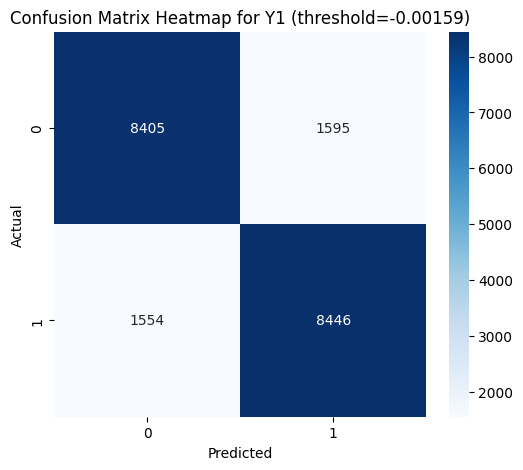

Y2 threshold = -0.318091
        Pred 0  Pred 1
True 0    8413    1587
True 1    2826    7174

               precision    recall  f1-score   support

           0      0.749     0.841     0.792     10000
           1      0.819     0.717     0.765     10000

    accuracy                          0.779     20000
   macro avg      0.784     0.779     0.778     20000
weighted avg      0.784     0.779     0.778     20000



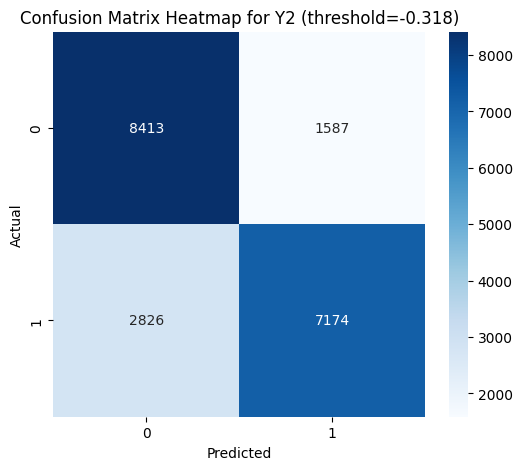

In [73]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix, classification_report

# --- load ---
df = pd.read_csv("train.csv")

def plot_confusion_heatmap(
    df: pd.DataFrame,
    target: str = "Y1",
    threshold: str | float = "median",  # "median", "zero", or numeric
    test_size: float = 0.25,
    random_state: int = 42
):
    assert target in df.columns, f"Target {target} not found."
    feature_cols = [c for c in df.columns if c not in ("Y1","Y2")]
    X = df[feature_cols].to_numpy()
    y_cont = df[target].to_numpy()

    # --- binarize target ---
    if threshold == "median":
        t = float(np.nanmedian(y_cont))
    elif threshold == "zero":
        t = 0.0
    else:
        t = float(threshold)
    y = (y_cont > t).astype(int)

    # --- split & scale ---
    X_train, X_test, y_train, y_test = train_test_split(
        X, y, test_size=test_size, random_state=random_state, stratify=y
    )
    scaler = StandardScaler()
    X_train = scaler.fit_transform(X_train)
    X_test  = scaler.transform(X_test)

    # --- train classifier ---
    clf = LogisticRegression(max_iter=500)
    clf.fit(X_train, y_train)
    y_pred = clf.predict(X_test)

    # --- confusion matrix ---
    cm = confusion_matrix(y_test, y_pred, labels=[0,1])
    print(f"{target} threshold = {t:.6g}")
    print(pd.DataFrame(cm, index=["True 0","True 1"], columns=["Pred 0","Pred 1"]))
    print("\n", classification_report(y_test, y_pred, digits=3))

    # --- plot heatmap ---
    plt.figure(figsize=(6,5))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=[0,1], yticklabels=[0,1])
    plt.title(f"Confusion Matrix Heatmap for {target} (threshold={t:.3g})")
    plt.xlabel("Predicted")
    plt.ylabel("Actual")
    plt.show()

    X_raw  = scaler.transform(X)
    y_results = clf.predict(X_raw)

    return y_results



# ---- usage ----
# For Y1
df_y1_pred = plot_confusion_heatmap(df, target="Y1", threshold="median")

# For Y2
df_y2_pred = plot_confusion_heatmap(df, target="Y2", threshold="median")


In [ ]:
value_cols = df.columns[df.columns.get_loc("A"): df.columns.get_loc("Y2") + 1]

fig = go.Figure()

fig.add_trace(
    go.Scatter(
        x=df["time"],
        y=df["Y1"],
        mode="lines",
        name = "original"
        
    )
)

fig.add_trace(
    go.Scatter(
        x=df["time"],
        y=df_y1_pred,
        mode="lines",
        name='predicted',
    )
)
fig.update_layout(
    title="Train Columns A to Y2 over Time",
    xaxis_title="Time",
    yaxis_title="Value",
)

fig.show()

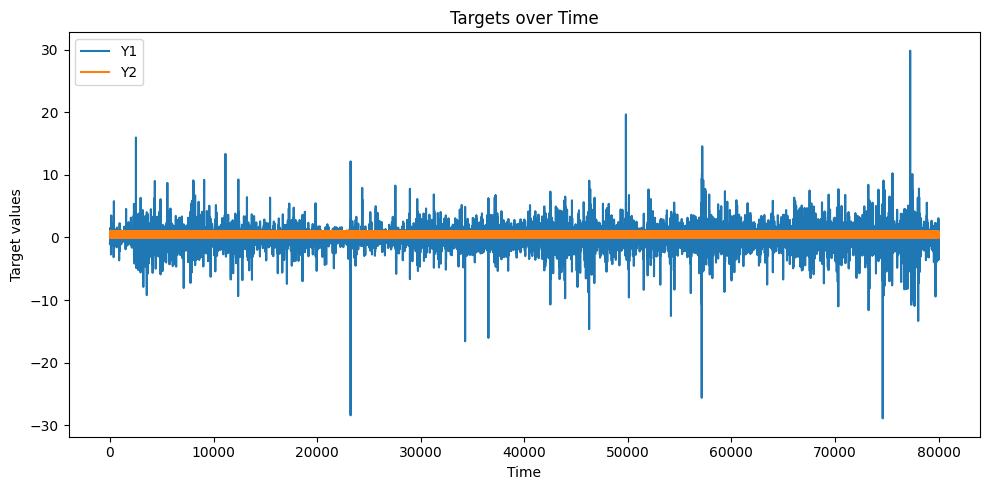

In [ ]:
# value_cols = df.columns[df.columns.get_loc("A"): df.columns.get_loc("Y2") + 1]


fig, ax = plt.subplots(figsize=(10, 5))
# ax.plot(df["time"], , label="Y1")
ax.plot(df["Y1"], df_y1_pred, label="Y2")
ax.set_xlabel("Time")
ax.set_ylabel("Target values")
ax.set_title("Targets over Time")
ax.legend()
plt.tight_layout()
plt.show()